# 2 coil optimization

Uniform randomized start points

In [4]:
import numpy as np
from scipy.optimize import minimize, Bounds
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from maggeometry import two_rings
import magpylib as magpy
from magpylib.magnet import CylinderSegment
from alive_progress import alive_bar

Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)

# cost function
def nonuniformity(x):
    innerrad, width, thickness, dist = x
    magnets = two_rings(Br, innerrad, width, thickness, dist)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return av_nonuniformity

# innerrad, width, thickness, dist
# bounds = ([1, 2, 2, 1], [150, 10, 20, 300])
bounds = ((1, 150), (2, 10), (2, 20), (1, 300))
options = {'disp':True, 'fatol': 5e-17}
method = "Nelder-Mead"


shots = 50
min_cost = 1e9
results_x = []
results_fun = []
with alive_bar(shots, force_tty=True) as bar:
    for i in range(shots):

        x0 = [0, 0, 0, 0]
        for b in range(len(bounds)):
            x0[b] = np.random.uniform(low=bounds[b][0], high=bounds[b][1])
        res = minimize(nonuniformity, x0, method=method, options=options, bounds=bounds)
        results_x.append(res.x)
        results_fun.append(res.fun)
        bar()

print(results_fun)

on 0: Optimization terminated successfully.                                     
on 0:          Current function value: 0.000001                                 
on 0:          Iterations: 280                                                  
on 0:          Function evaluations: 578                                        
on 1: Optimization terminated successfully.                                     
on 1:          Current function value: 0.000370                                 
on 1:          Iterations: 32                                                   
on 1:          Function evaluations: 50                                         


on 2: /var/folders/06/7pjfbw510cz2ch1m7lx8vvl80000gn/T/ipykernel_18813/1566828833.py:37: RuntimeWarning: Maximum number of function evaluations has been exceeded.
        res = minimize(nonuniformity, x0, method=method, options=options, bounds=bounds)


on 6: Optimization terminated successfully.                                     
on 6:          Current function value: 0.000366                                 
on 6:          Iterations: 46                                                   
on 6:          Function evaluations: 73                                         
on 10: Optimization terminated successfully.                                    
on 10:          Current function value: 0.000437                                
on 10:          Iterations: 39                                                  
on 10:          Function evaluations: 65                                        
on 11: Optimization terminated successfully.                                    
on 11:          Current function value: 0.000001                                
on 11:          Iterations: 282                                                 
on 11:          Function evaluations: 600                                       
on 12: Optimization terminat

In [51]:
print (results_x)

[array([149.99999985,   4.90535641,  14.90284662, 258.32656174]), array([150.,  10.,   2., 300.]), array([150.        ,  10.        ,  20.        ,  56.19870116]), array([150.        ,  10.        ,  20.        , 262.80598541]), array([149.99998553,   9.9921745 ,   2.        , 262.28775424]), array([150.        ,   9.99999831,   2.        ,  55.820054  ]), array([150.,  10.,  20., 300.]), array([149.99999984,   2.18941635,   9.08026376, 255.8585066 ]), array([149.99999784,   2.        ,  17.06566888, 255.97561102]), array([149.99998618,   8.13384182,   2.11937887, 260.74135921]), array([150.,   2.,   2., 300.]), array([150.        ,   8.26683504,   4.89529451, 260.87762299]), array([150.,  10.,   2., 300.]), array([150.,  10.,   2., 300.]), array([150.,   2.,   2., 300.]), array([149.99999998,   9.98580429,   6.73240915, 262.33582197]), array([149.99999897,   4.44037514,   2.        , 257.64942213]), array([150.        ,   5.01334449,  13.00373617, 258.34751261]), array([149.99999902, 

[[9.04352986e-07 1.50000000e+02 1.00000000e+01 2.00000000e+01
  2.62805985e+02]
 [9.04854767e-07 1.49992906e+02 1.00000000e+01 1.78325657e+01
  2.62687317e+02]
 [9.05582442e-07 1.49999909e+02 9.99012721e+00 1.02820779e+01
  2.62417675e+02]
 [9.05698646e-07 1.50000000e+02 9.99999972e+00 6.51022438e+00
  2.62343925e+02]
 [9.05841605e-07 1.49999999e+02 1.00000000e+01 2.08084185e+00
  2.62294692e+02]
 [9.05844988e-07 1.49999909e+02 9.99999878e+00 2.00000000e+00
  2.62294114e+02]
 [9.05854298e-07 1.50000000e+02 9.98580429e+00 6.73240915e+00
  2.62335822e+02]
 [9.05890838e-07 1.50000000e+02 9.99596028e+00 2.03069952e+00
  2.62290998e+02]
 [9.05935240e-07 1.49999986e+02 9.99217450e+00 2.00000000e+00
  2.62287754e+02]
 [9.05946315e-07 1.49999985e+02 9.99141961e+00 2.00000000e+00
  2.62287199e+02]
 [9.06064276e-07 1.49999998e+02 9.96250111e+00 7.87970014e+00
  2.62338310e+02]
 [9.06343220e-07 1.49978640e+02 9.99995176e+00 2.00000000e+00
  2.62257926e+02]
 [9.06991537e-07 1.49950986e+02 9.999872

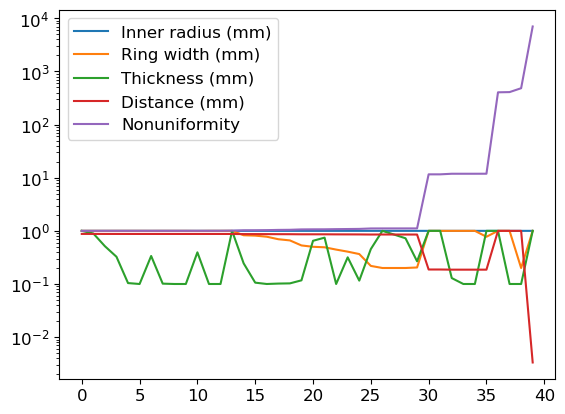

In [105]:
results_fun = results_fun.flatten()
res_f = np.array([np.array(results_fun.flatten())])
res_x = np.array(results_x)
a = np.concatenate((res_f.T, res_x), axis=1)
b = a[a[:, 0].argsort()]
new_array = [tuple(row) for row in b]
u = np.unique(new_array, axis=0)
print(u)
x = np.arange(len(u))

bounds = ((1, 150), (2, 10), (2, 20), (1, 300))
def proportion(arr, n):
#     result = (arr) / np.min(arr)
    result = arr / bounds[n][1]
    return result

plt.plot(x, proportion(u[:,1], 0), label='Inner radius (mm)')
plt.plot(x, proportion(u[:,2], 1), label='Ring width (mm)')
# plt.plot(x, b[:,2], label='Ring width (mm)')
plt.plot(x, proportion(u[:,3], 2), label='Thickness (mm)')
# plt.plot(x, b[:,3], label='Thickness (mm)')
# plt.plot(x, b[:,4], label='Distance (mm)')
plt.plot(x, proportion(u[:,4], 3), label='Distance (mm)')
plt.plot(x, u[:,0]/np.min(u[:,0]), label='Nonuniformity') 
# plt.plot(x, b[:,0], label='nonuniformity')
plt.yscale('log')
plt.legend()

[150.          10.          20.         262.80598541]


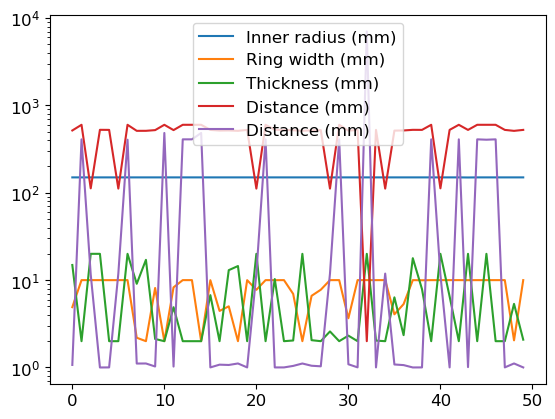

In [50]:
import matplotlib.pyplot as plt
index = np.argmin(results_fun)
print(results_x[index])
# print(results_x[-1])
# print(results_x[-3])
# print(results_x[-7])
# print(np.array(results_x)[:,3])
x = np.arange(shots)
plt.plot(x, np.array(results_x)[:,0], label='Inner radius (mm)')
plt.plot(x, np.array(results_x)[:,1], label='Ring width (mm)')
plt.plot(x, np.array(results_x)[:,2], label='Thickness (mm)')
plt.plot(x, np.array(results_x)[:,3]*2, label='Distance (mm)')
plt.plot(x, np.array(results_fun)/np.min(results_fun), label='Distance (mm)')
plt.yscale('log')
plt.legend()

On x-axis:
Maximum B-field: 14.578 G
Central B-field: 14.578 G
Min nonuniformity: 0.0
Max nonuniformity:4.987441365372328e-05


On y-axis:
Maximum B-field: 14.578 G
Central B-field: 14.578 G
Min nonuniformity: 0.0
Max nonuniformity:4.987441365372328e-05


On z-axis:
Maximum B-field: 14.578 G
Central B-field: 14.578 G
Min nonuniformity: 0.0
Max nonuniformity:0.00020666458825583053


Uniform region width with threshold 1e-06: x = 2.144 cm, y = 2.144 cm, z = 0.67 cm


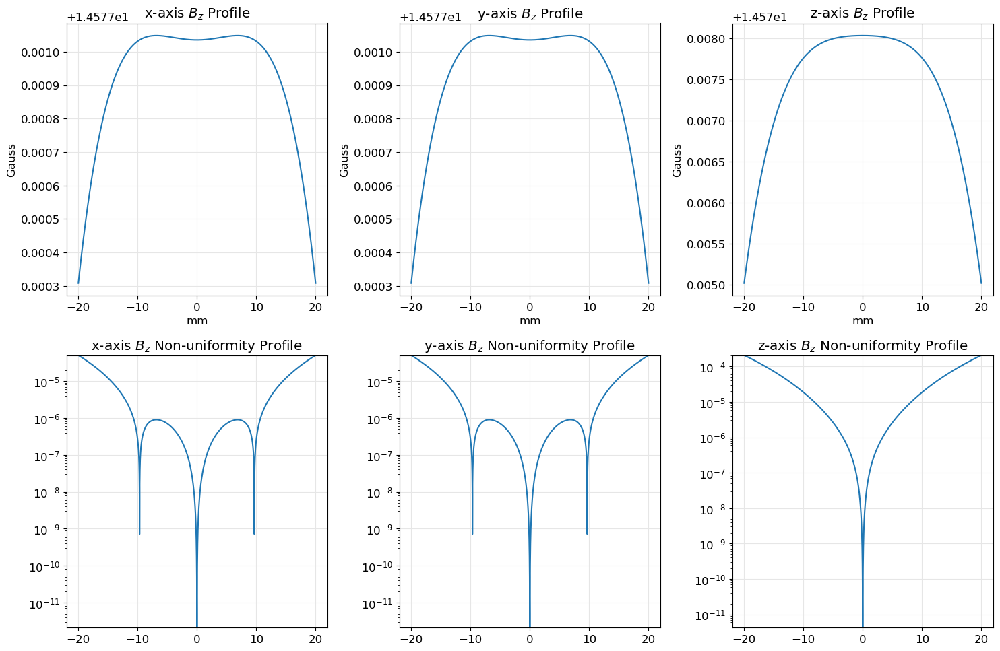

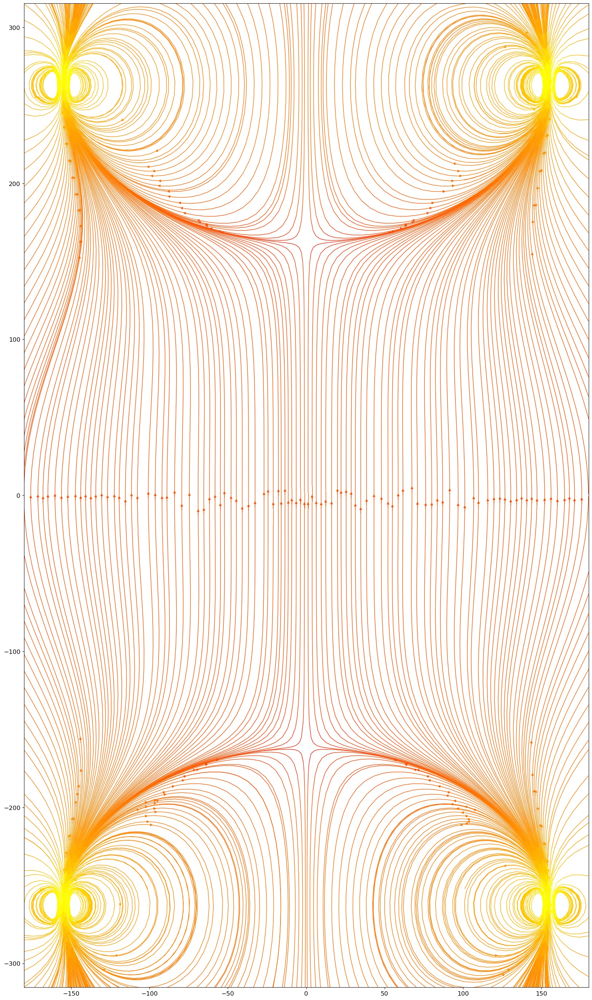

In [116]:
from maggeometry import two_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
innerrad, width, thickness, dist = u[0][1:]
Br = 1.09e3
magnets = two_rings(Br, innerrad, width, thickness, dist)

sens_len = 20
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-1.2*innerrad, 1.2*innerrad]
z_bounds = [-1.2*dist, 1.2*dist]

make_flux_stream(magnets, x_bounds, z_bounds, [])

In [114]:
import numpy as np
from scipy.optimize import minimize, Bounds
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from maggeometry import two_rings
import magpylib as magpy
from magpylib.magnet import CylinderSegment

Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
def nonuniformity(x):
    innerrad, width, thickness, dist = x
    magnets = two_rings(Br, innerrad, width, thickness, dist)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return av_nonuniformity

# innerrad, width, thickness, dist
bounds = Bounds([1, 1, 1, 1], [100, 10, 20, 100])
x0 = [30, 5, 2.4, 100]
options = {'disp':True, 'fatol': 1e-18}
# options = {'disp':True}
method = "Nelder-Mead"
res = minimize(nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000042
         Iterations: 297
         Function evaluations: 592
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 4.20110792586013e-05
             x: [ 5.444e+01  1.000e+01  1.000e+00  1.000e+02]
           nit: 297
          nfev: 592
 final_simplex: (array([[ 5.444e+01,  1.000e+01,  1.000e+00,  1.000e+02],
                       [ 5.444e+01,  1.000e+01,  1.000e+00,  1.000e+02],
                       ...,
                       [ 5.444e+01,  1.000e+01,  1.000e+00,  1.000e+02],
                       [ 5.444e+01,  1.000e+01,  1.000e+00,  1.000e+02]]), array([ 4.201e-05,  4.201e-05,  4.201e-05,  4.201e-05,
                        4.201e-05]))


Nelder-Mead solely

In [2]:
import numpy as np
from scipy.optimize import minimize, Bounds
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from maggeometry import two_rings
import magpylib as magpy
from magpylib.magnet import CylinderSegment

Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
def nonuniformity(x):
    innerrad, width, thickness, dist = x
    magnets = two_rings(Br, innerrad, width, thickness, dist)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return av_nonuniformity

# innerrad, width, thickness, dist
bounds = Bounds([1, 2, 2, 1], [150, 10, 20, 300])
x0 = [80, 5, 2.4, 200]
options = {'disp':True, 'fatol': 1e-17}
# options = {'disp':True}
method = "Nelder-Mead"
res = minimize(nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

       message: Maximum number of function evaluations has been exceeded.
       success: False
        status: 1
           fun: 9.058115048955658e-07
             x: [ 1.500e+02  1.000e+01  4.591e+00  2.623e+02]
           nit: 412
          nfev: 800
 final_simplex: (array([[ 1.500e+02,  1.000e+01,  4.591e+00,  2.623e+02],
                       [ 1.500e+02,  1.000e+01,  4.591e+00,  2.623e+02],
                       ...,
                       [ 1.500e+02,  1.000e+01,  4.591e+00,  2.623e+02],
                       [ 1.500e+02,  1.000e+01,  4.591e+00,  2.623e+02]]), array([ 9.058e-07,  9.058e-07,  9.058e-07,  9.058e-07,
                        9.058e-07]))


/var/folders/06/7pjfbw510cz2ch1m7lx8vvl80000gn/T/ipykernel_17742/1172614168.py:23: RuntimeWarning: Maximum number of function evaluations has been exceeded.
  res = minimize(nonuniformity, x0, method=method, options=options, bounds=bounds)


On x-axis:
Maximum B-field: 3.354 G
Central B-field: 3.354 G
Min nonuniformity: 0.0
Max nonuniformity:8.988226413525971e-07


On y-axis:
Maximum B-field: 3.354 G
Central B-field: 3.354 G
Min nonuniformity: 0.0
Max nonuniformity:8.988226413525971e-07


On z-axis:
Maximum B-field: 3.354 G
Central B-field: 3.354 G
Min nonuniformity: 0.0
Max nonuniformity:1.864439653760633e-05




/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:163: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[3].set_ylim(x_min_nonuniformity - 1e-7, x_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:168: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[4].set_ylim(y_min_nonuniformity - 1e-7, y_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:173: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[5].set_ylim(z_min_nonuniformity - 1e-7, z_max_nonuniformity + 1e-7)


IndexError: index -5001 is out of bounds for axis 0 with size 5000

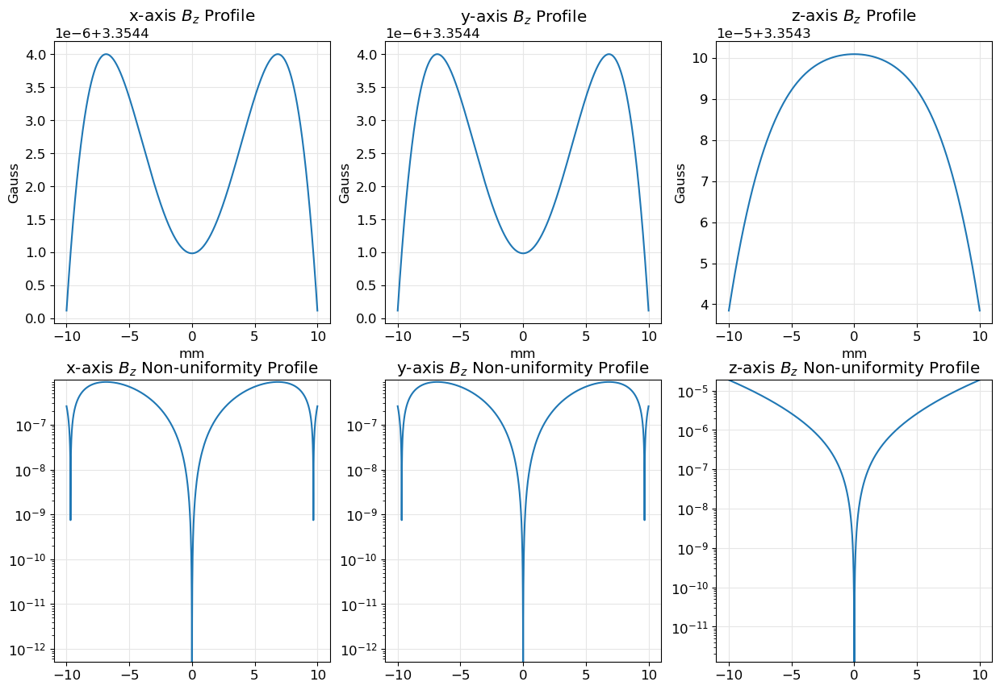

In [3]:
from maggeometry import two_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
innerrad, width, thickness, dist = res.x
Br = 1.09e3
magnets = two_rings(Br, innerrad, width, thickness, dist)

sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-1.2*innerrad, 1.2*innerrad]
z_bounds = [-1.2*dist, 1.2*dist]

make_flux_stream(magnets, x_bounds, z_bounds, [])

Nelder-Mead

In [1]:
import numpy as np
from scipy.optimize import minimize, Bounds
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from maggeometry import two_rings
import magpylib as magpy
from magpylib.magnet import CylinderSegment

Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
def max_nonuniformity(x):
    innerrad, width, thickness, dist = x
    magnets = two_rings(Br, innerrad, width, thickness, dist)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_abs_nonuniformity

# innerrad, width, thickness, dist
bounds = Bounds([1, 2, 2, 1], [150, 10, 20, 300])
x0 = [80, 5, 2.4, 200]
options = {'disp':True, 'fatol': 1e-17}
# options = {'disp':True}
method = "Nelder-Mead"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

       message: Maximum number of function evaluations has been exceeded.
       success: False
        status: 1
           fun: 3.0167759613026313e-06
             x: [ 1.500e+02  4.666e+00  2.000e+00  2.577e+02]
           nit: 391
          nfev: 800
 final_simplex: (array([[ 1.500e+02,  4.666e+00,  2.000e+00,  2.577e+02],
                       [ 1.500e+02,  4.666e+00,  2.000e+00,  2.577e+02],
                       ...,
                       [ 1.500e+02,  4.666e+00,  2.000e+00,  2.577e+02],
                       [ 1.500e+02,  4.666e+00,  2.000e+00,  2.577e+02]]), array([ 3.017e-06,  3.017e-06,  3.017e-06,  3.017e-06,
                        3.017e-06]))


/var/folders/06/7pjfbw510cz2ch1m7lx8vvl80000gn/T/ipykernel_49279/349111908.py:23: RuntimeWarning: Maximum number of function evaluations has been exceeded.
  res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)


In [2]:
print(res.x)

[149.99998021   4.66575469   2.         257.6962785 ]


On x-axis:
Maximum B-field: 0.706 G
Central B-field: 0.706 G
Min nonuniformity: 0.0
Max nonuniformity:3.0167993499254836e-06


On y-axis:
Maximum B-field: 0.706 G
Central B-field: 0.706 G
Min nonuniformity: 0.0
Max nonuniformity:3.0167993499254836e-06


On z-axis:
Maximum B-field: 0.706 G
Central B-field: 0.706 G
Min nonuniformity: 0.0
Max nonuniformity:2.63773874263747e-05




/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:152: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[3].set_ylim(x_min_nonuniformity - 1e-7, x_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:157: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[4].set_ylim(y_min_nonuniformity - 1e-7, y_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:162: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[5].set_ylim(z_min_nonuniformity - 1e-7, z_max_nonuniformity + 1e-7)


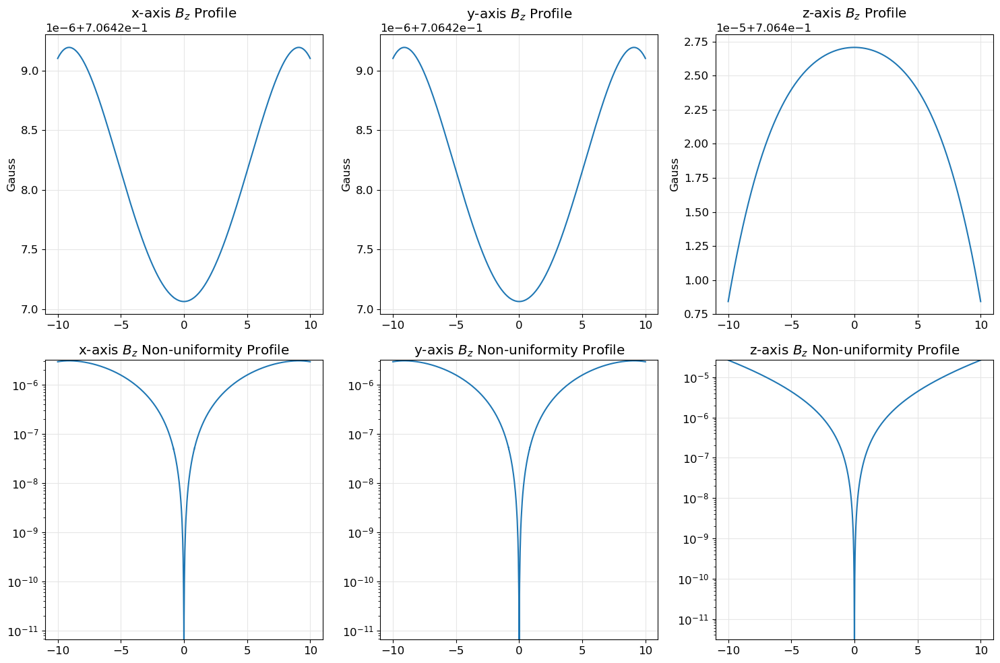

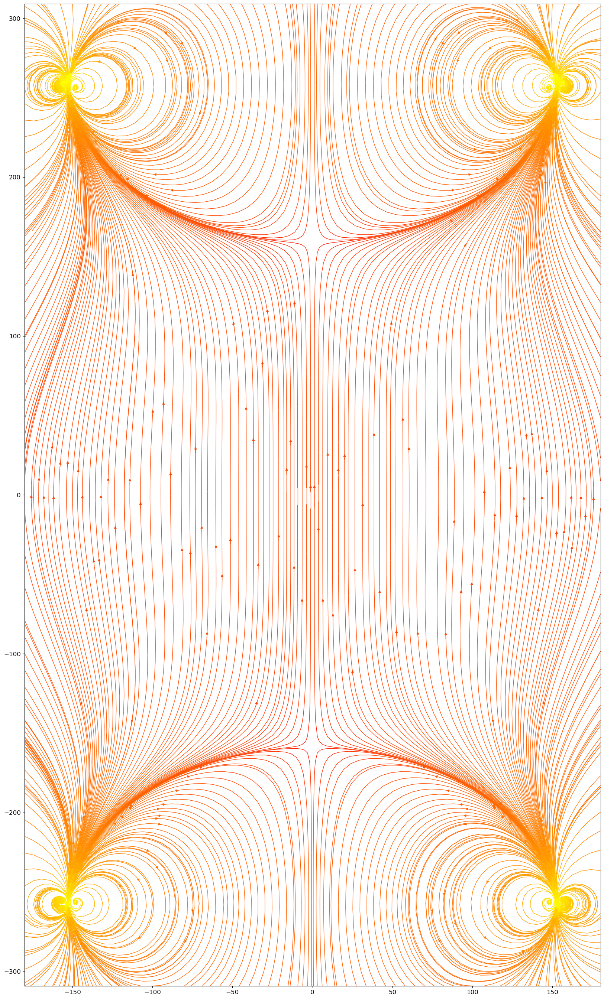

In [3]:
from maggeometry import two_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
innerrad, width, thickness, dist = res.x
Br = 1.09e3
magnets = two_rings(Br, innerrad, width, thickness, dist)

sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-1.2*innerrad, 1.2*innerrad]
z_bounds = [-1.2*dist, 1.2*dist]

make_flux_stream(magnets, x_bounds, z_bounds, [])

Powell

In [4]:
# innerrad, width, thickness, dist
bounds = Bounds([1, 2, 2, 1], [150, 10, 20, 300])
x0 = [10, 5, 2.4, 200]
options = {'disp':True}
method = "Powell"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000008
         Iterations: 3
         Function evaluations: 409
 message: Optimization terminated successfully.
 success: True
  status: 0
     fun: 8.298077236878505e-06
       x: [ 1.158e+02  5.000e+00  2.390e+00  2.000e+02]
     nit: 3
   direc: [[ 5.182e-04  1.867e-10 -2.284e-08 -8.509e-11]
           [ 0.000e+00  1.000e+00  0.000e+00  0.000e+00]
           [ 0.000e+00  0.000e+00  1.000e+00  0.000e+00]
           [ 4.906e-06  2.466e-07 -3.987e-05  8.375e-06]]
    nfev: 409


On x-axis:
Maximum B-field: 1.501 G
Central B-field: 1.501 G
Min nonuniformity: 0.0
Max nonuniformity:8.298086296484431e-06


On y-axis:
Maximum B-field: 1.501 G
Central B-field: 1.501 G
Min nonuniformity: 0.0
Max nonuniformity:8.298086296484431e-06


On z-axis:
Maximum B-field: 1.501 G
Central B-field: 1.501 G
Min nonuniformity: 0.0
Max nonuniformity:7.271586847296238e-05




/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:152: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.

/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:157: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.

/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:162: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.



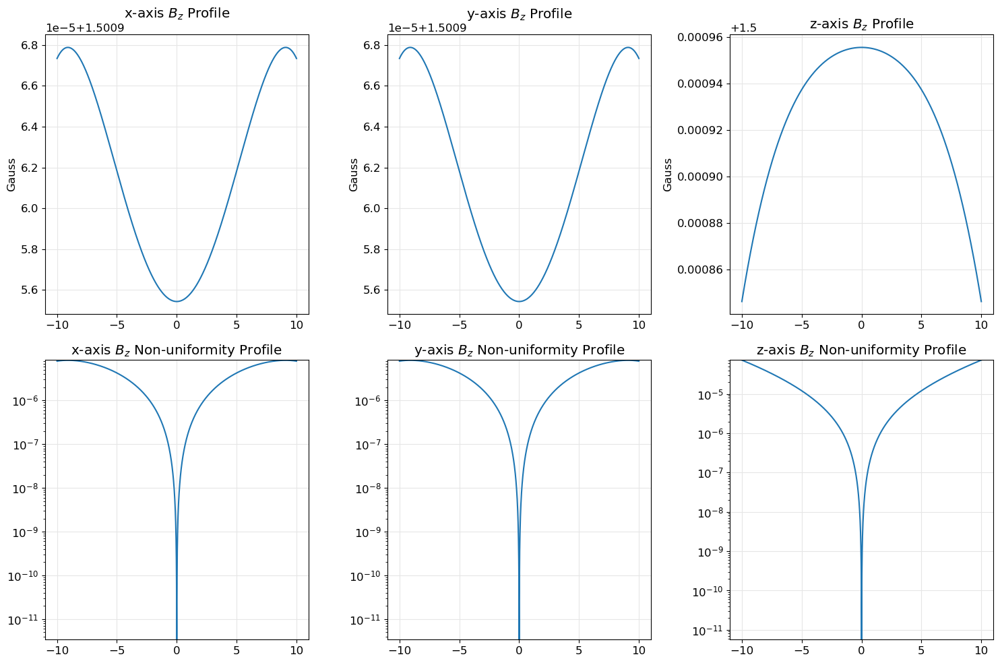

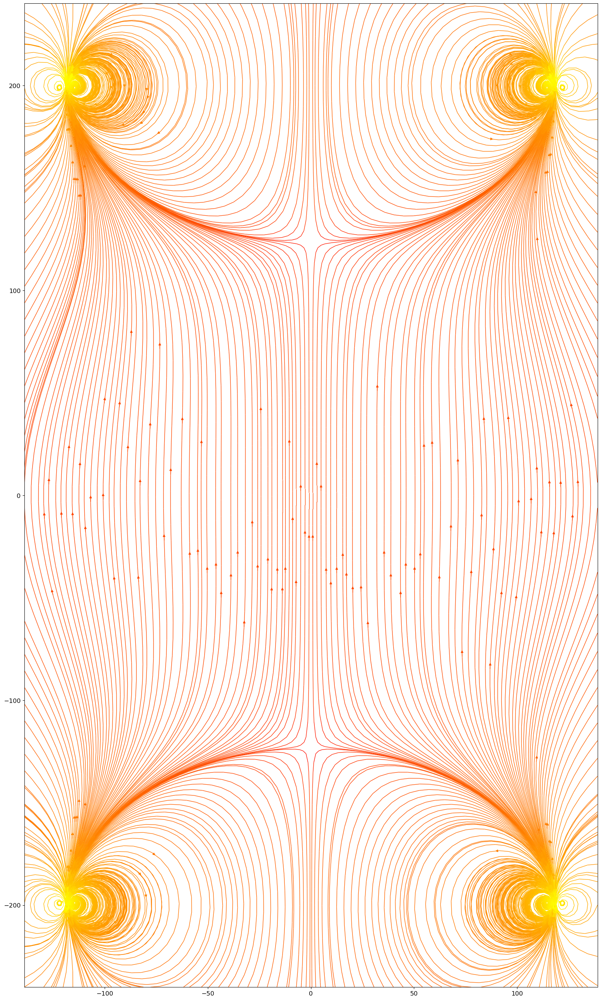

In [5]:
from maggeometry import two_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
innerrad, width, thickness, dist = res.x
Br = 1.09e3
magnets = two_rings(Br, innerrad, width, thickness, dist)

sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-1.2*innerrad, 1.2*innerrad]
z_bounds = [-1.2*dist, 1.2*dist]

make_flux_stream(magnets, x_bounds, z_bounds, [])